https://www.kaggle.com/c/home-credit-default-risk/data

# Table of Contents

Understanding the problem and familiarization with the data
Data cleaning and formatting
EDA
Basic model
Model improvement
Model Interpretation

1. [Overview](#overview) INTRO
Objective / Questions ==>  probability of Default on LOAN ????/

2. [Setup & Data](#Data)
Import Data
Import Python Packages
Import Libraries for ML Models

3. [Data Wrangling](#Data)
Clean Data
DEFINITIONS... DEFINE dubious data...???

4. [EDA](#EDA)
visualization
Matplots
Seaborn
 
5. [Feature Engineering](#Feature Engineering)

6.  Basic model + more models
Model N#01 ==> Logistic Regression
Model N#02 ==> XGBoost ????? EXTRA--???

7. [Interactive Dashboard](#) --> TabPy

8. [Conclusion](#conclusion)
NEXT STEPS: improve model... 
+NLP sentiment analysis

9. [Photo and Data Credits](#photo-and-data-credits)
THANKS.... (PUB: for my blog... if its ready for LAUNCH...???)



(How to make this INDEX names JUMP to correct place

Also FINISH the READ.me --> File

## CONTENT - readMe file type ???

## INTRO
Home Credit is a non-banking financial institution, founded in 1997 in the Czech Republic.

The company operates in 14 countries (including United States, Russia, Kazahstan, Belarus, China, India) and focuses on lending primarily to people with little or no credit history which would typicaly either: not obtain loans or became victims of untrustworthly lenders.

Home Credit group has over 29 million customers, total assests of 21 billions Euro, over 160 millions loans, with the majority in Asia and and almost half of them in China (as of 19-05-2018).

The company uses of a variety of alternative data - including telco and transactional information - to predict their clients' repayment abilities.

They made available their data to the Kaggle community and are challenging Kagglers to help them unlock the full potential of their data.

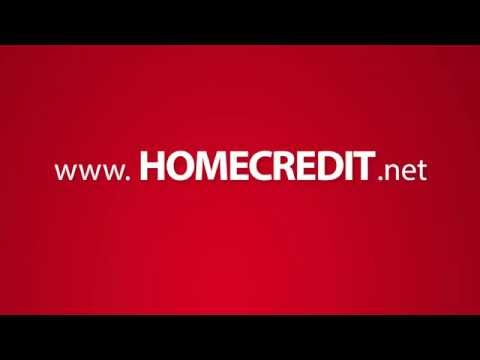

In [2]:
from IPython.display import YouTubeVideo
YouTubeVideo('QOO14BQITz4', width=700, height=400)

## Questions / Challenge

The most important task for any lender is to predict the probability of default for a borrower. An accurate prediction can help in balancing risk and return for the lender; charging higher rates for higher risks, or even denying the loan when required.

This helps genuine borrowers also as they can get loans as per their risk-profiles; also lower default-rates help in keeping the rates lower.

So I decided to apply the machine learning skills gained by me to prediction of probability-of-default on loans.

## Data Source:
We can get the complete data required for this problem from the link : https://www.kaggle.com/c/home-credit-default-risk/data

### There are a total of 10 files:
Main table is broken into two files for Train (with TARGET) and Test (without TARGET).

1 main file for training (with target) ==> (application_train.csv)

1 main file for testing (without the target), ==> (application_test.csv)

+
1 example submission file ==> (sample_submission.csv)


### 6 other files containing additional information about each loan:

bureau_balance.csv

bureau.csv

credit_card_balance.csv

installments_payments.csv

POS_CASH_balance.csv

previous_application.csv

In [4]:
## Load the PACKAGES 
## Do I need more?... 
## Should I "import" them as they get applied?

import pandas as pd # package for high-performance, easy-to-use data structures and data analysis
import numpy as np # fundamental package for scientific computing with Python
import matplotlib
import matplotlib.pyplot as plt # for plotting
import seaborn as sns # for making plots with seaborn
color = sns.color_palette()
import plotly.offline as py
py.init_notebook_mode(connected=True)
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.offline as offline
offline.init_notebook_mode()

In [ ]:
???

## Data Sets

In [5]:
## Load the DATA
application_train = pd.read_csv('/Users/mauroaz/Downloads/home-credit-default-risk_02/application_train.csv')
POS_CASH_balance = pd.read_csv('/Users/mauroaz/Downloads/home-credit-default-risk_02/POS_CASH_balance.csv')
bureau_balance = pd.read_csv('/Users/mauroaz/Downloads/home-credit-default-risk_02/bureau_balance.csv')
previous_application = pd.read_csv('/Users/mauroaz/Downloads/home-credit-default-risk_02/previous_application.csv')
installments_payments = pd.read_csv('/Users/mauroaz/Downloads/home-credit-default-risk_02/installments_payments.csv')
credit_card_balance = pd.read_csv('/Users/mauroaz/Downloads/home-credit-default-risk_02/credit_card_balance.csv')
bureau = pd.read_csv('/Users/mauroaz/Downloads/home-credit-default-risk_02/bureau.csv')
application_test = pd.read_csv('/Users/mauroaz/Downloads/home-credit-default-risk_02/application_test.csv')

In [6]:
print ("   Data-Sets        N# of rows & columns       ")
print ("application_train     :",application_train.shape)
print ("application_test      :",application_test.shape)
print ("bureau                :",bureau.shape)
print ("bureau_balance        :",bureau_balance.shape)
print ("credit_card_balance   :",credit_card_balance.shape)
print ("installments_payments :",installments_payments.shape)
print ("POS_CASH_balance      :",POS_CASH_balance.shape)
print ("previous_application  :",previous_application.shape)

   Data-Sets        N# of rows & columns       
application_train     : (307511, 122)
application_test      : (48744, 121)
bureau                : (1716428, 17)
bureau_balance        : (1048575, 3)
credit_card_balance   : (3840312, 23)
installments_payments : (13605401, 8)
POS_CASH_balance      : (10001358, 8)
previous_application  : (1670214, 37)


### The SCHEMA below shows how the data is related:

![](home_credit.png)

## Data-Sets Contents
* application_train / application_test ==> Basic data, the borrower is identified by the SK_ID_CURR field


* bureau ==> Data concerning client’s previous credits from other financial institutions. Each previous credit has its own row in bureau, but one loan in the application data can have multiple previous credits.


* bureau_balance ==> Monthly data about the previous credits in bureau. Each row is one month of a previous credit, and a single previous credit can have multiple rows, one for each month of the credit length.


* previous_application ==> Data of previous applications for loans at Home Credit of clients who have loans in the application data. Each current loan in the application data can have multiple previous loans. Each previous application has one row and is identified by the feature SK_ID_PREV.


* POS_CASH_BALANCE ==> Monthly data on loans in Home Credit with cash and loans for purchases of goods. Each row is one month of a previous "point of sale" (purchases) or cash loan, and a single previous loan can have many rows.


* credit_card_balance ==> Monthly data about previous credit cards clients have had with Home Credit. Each row is one month of a credit card balance, and a single credit card can have many rows.


* installments_payment ==> Billing history of previous loans in Home Credit. There is one row for every made payment and one row for every missed payment.

## Data Description
Home Credit had provided a file -- “HomeCreditcolumnsdescription.csv” -- having a brief description of all the columns in different files. The description of these columns was useful in feature engineering. 

Plus I was able to get further insight into several files by consulting the "Discussion" board in the Kaggle community relevant to this "Home Credit" challenge.

## Data Linkage
Application train & test were the primary files corresponding to the loan applications. Predictions were to be made about the test file.

Main tracking id linking the loan application data in these files to secondary and tertiary files was:
* SK_ID_CURR
* Bureau
* previous_appl 

These were the secondary files which had information about other loans and applications of these loan applicants. 

They were linked through SK_ID_BUREAU and SK_ID_PREV to the payment information about these loans in tertiary files.

In [7]:
application_train.shape

(307511, 122)

In [8]:
application_test.shape

(48744, 121)

In total we have over 307 thousand records and 122 columns in the TRAIN-ing sample and over 48 thousand records and 121 columns in the TEST sample. 

(OBS: There is one less column in the TEST sample because it doesn't include the TARGET feature, which our ML MODEL will attempt to predict.)

### application_train

In [9]:
application_train.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


### application_test

In [10]:
application_test.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


In [11]:
application_train.info(max_cols=122)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
SK_ID_CURR                      307511 non-null int64
TARGET                          307511 non-null int64
NAME_CONTRACT_TYPE              307511 non-null object
CODE_GENDER                     307511 non-null object
FLAG_OWN_CAR                    307511 non-null object
FLAG_OWN_REALTY                 307511 non-null object
CNT_CHILDREN                    307511 non-null int64
AMT_INCOME_TOTAL                307511 non-null float64
AMT_CREDIT                      307511 non-null float64
AMT_ANNUITY                     307499 non-null float64
AMT_GOODS_PRICE                 307233 non-null float64
NAME_TYPE_SUITE                 306219 non-null object
NAME_INCOME_TYPE                307511 non-null object
NAME_EDUCATION_TYPE             307511 non-null object
NAME_FAMILY_STATUS              307511 non-null object
NAME_HOUSING_TYPE               307511 non-null object
REGION_

## EDA - Exploratory Data Analysis

In [12]:
application_train.TARGET.value_counts()

0    282686
1     24825
Name: TARGET, dtype: int64

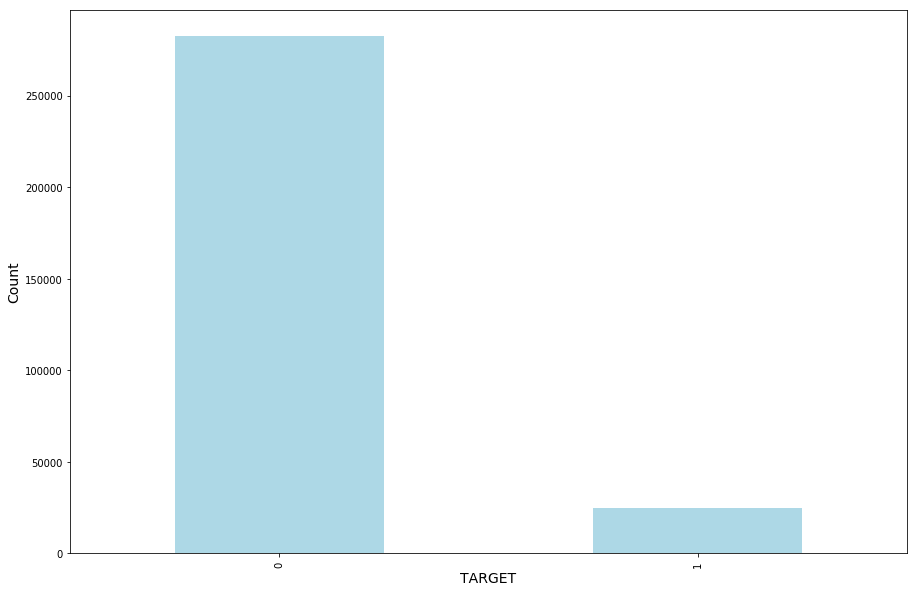

In [13]:
# Plot target distribution
feature = "TARGET"

ax = application_train[feature].value_counts().plot(kind='bar',
                                    figsize=(15,10), 
                                    color='lightblue')
ax.set_xlabel(feature, fontsize=14)
ax.set_ylabel("Count", fontsize=14)
plt.show()

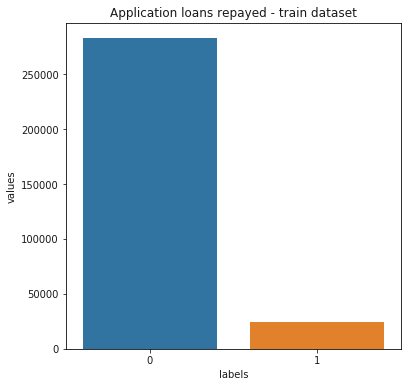

In [53]:
temp = application_train["TARGET"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
plt.figure(figsize = (6,6))
plt.title('Application loans repayed - train dataset')
sns.set_color_codes("pastel")
sns.barplot(x = 'labels', y="values", data=df)
locs, labels = plt.xticks()
plt.show()

TARGET definitions:
* 1 represents any problems that occured which led the clients to DEFAULT 
* 0 represents that the clients REPAYED LOAN

OBS: 
Our target distribution is highly imbalanced with 80% of clients repaying their loans on time. 

This is a favorable outcome for Home Credit, but will definitely inform how we evaluate our classifier.

When the target variable’s distribution is imbalanced, accuracy is not a good metric to evaluate model performance.

In [14]:
import cufflinks as cf
cf.go_offline()
# https://plot.ly/python/v3/ipython-notebooks/cufflinks/
# https://anaconda.org/gwinnen/plotly-and-cufflinks/notebook

In [15]:
cf.set_config_file(theme='polar')
contract_val = application_train['TARGET'].value_counts()
contract_df = pd.DataFrame({'labels': contract_val.index,
                   'values': contract_val.values
                  })
contract_df.iplot(kind='pie',labels='labels',values='values', title='Loans Repaid or Default', hole = 0.6)

## OBS:
Here we can see in percentage exactly how imbalanced the data is:
* 90.5%  (Loan repayed = 0)
* 9.52%  (Loan not repayed = 1)

SOURCE: https://medium.com/@praveenkotha/home-credit-default-risk-end-to-end-machine-learning-project-1871f52e3ef2

##### Performance Metric:
In this problem, the data is imbalanced. So we can’t use accuracy as a error metric. 

When data is imbalanced we can use Log loss, F1-score and AUC. 

Here we are sticking to AUC which can handle imbalanced datasets.
Area Under Curve (AUC)

An ROC curve is the most commonly used way to visualize the performance of a binary classifier, and AUC is (arguably) the best way to summarize its performance in a single number.

Confusion Matrix (To get an overview of complete predictions)


???????
ADD a Utube Vid ????

### Advantages of AUC vs standard accuracy
??? Source: https://datascience.stackexchange.com/questions/806/advantages-of-auc-vs-standard-accuracy

## Understanding Metrics - https://www.youtube.com/watch?v=iKLvTiikQao

When it comes time to build our machine learning models, 

we will have to fill in these missing values (known as imputation). 

In later work, we will use models such as XGBoost that can handle missing values 
with no need for imputation. 

Another option would be to drop columns with a high percentage of missing values, 

although it is impossible to know ahead of time if these columns will be helpful to our model. 

Therefore, we will keep all of the columns for now.

### Column Types
Let's look at the number of columns of each data type. 

int64 and float64 are numeric variables (which can be either discrete or continuous). ==> use this in TABLEAU

object columns contain strings and are categorical features. .

In [71]:
# Number of each type of column
application_train.dtypes.value_counts()

float64    65
int64      41
object     16
dtype: int64

Let's now look at the number of unique entries in each of the object (categorical) columns.

In [72]:
# Number of unique classes in each object column
application_train.select_dtypes('object').apply(pd.Series.nunique, axis = 0)

NAME_CONTRACT_TYPE             2
CODE_GENDER                    3
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               8
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             6
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE             4
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

## Encoding Categorical Variables
Before we go any further, we need to deal with "buggy/problemstic" categorical variables. 

A machine learning model unfortunately cannot deal with categorical variables (except for some models such as LightGBM). 

Therefore, we have to find a way to encode (Represent) these variables as numbers before handing 
them off to the model. 

#### There are two main ways to carry out this process:

### Label encoding: 
    assign each unique category in a categorical variable with an integer. No new columns are created. An example is shown below

### One-hot encoding: 
    create a new column for each unique category in a categorical variable. 
    
    Each observation recieves a 1 in the column for its corresponding category and a 0 in all other new columns.
    
#### TensorFlow + One-hot encoding ==> https://www.youtube.com/watch?v=Gql-LxoGvXA

#### Dummy Variables  + One-hot encoding ==> https://www.youtube.com/watch?v=9yl6-HEY7_s
    

### ????
No more search, here https://www.kaggle.com/willkoehrsen/start-here-a-gentle-introduction

Recheck if these are the best links
    https://www.youtube.com/watch?v=9yl6-HEY7_s

## Dimensionality_reduction - https://en.wikipedia.org/wiki/Dimensionality_reduction

After we decide on the ENCODING.... 

"Label Encoding VS One-hot encoding"


the data will be much better suited for MACHINE LEARNING...???Research more??

but, altough it seems "better" it may also nees a Dimensionality_reduction

https://en.wikipedia.org/wiki/Dimensionality_reduction

### Aligning Training and Testing Data
There need to be the same features (columns) in both the training and testing data. One-hot encoding has created more columns in the training data because there were some categorical variables with categories not represented in the testing data. To remove the columns in the training data that are not in the testing data, we need to align the dataframes. First we extract the target column from the training data (because this is not in the testing data but we need to keep this information). When we do the align, we must make sure to set axis = 1 to align the dataframes based on the columns and not on the rows!

## Imputation
what exactly is "Imputation"

In [ ]:
### ???
why allign: Training data + TEsting Data

In [ ]:
????

The training and testing datasets now have the same features which is required for machine learning. The number of features has grown significantly due to one-hot encoding. At some point we probably will want to try dimensionality reduction (removing features that are not relevant) to reduce the size of the datasets.

In [ ]:
?????????????

## Back to Exploratory Data Analysis
#### Anomalies
One problem we always want to be on the lookout for when doing EDA is anomalies within the data. 


These may be due to mis-typed numbers, errors in measuring equipment, or they could be valid but extreme measurements. 


One way to support anomalies quantitatively is by looking at the statistics of a column using the describe method. 

The numbers in the DAYS_BIRTH column are negative because they are recorded relative to the current loan application. 

To see these stats in years, we can mutliple by -1 and divide by the number of days in a year:

In [74]:
(application_train['DAYS_BIRTH'] / -365).describe()

count    307511.000000
mean         43.936973
std          11.956133
min          20.517808
25%          34.008219
50%          43.150685
75%          53.923288
max          69.120548
Name: DAYS_BIRTH, dtype: float64

##### OBS: 
    Those ages look reasonable. 
    There are no outliers for the age on either the high or low end. 
    How about the days of employment?

In [75]:
application_train['DAYS_EMPLOYED'].describe()

count    307511.000000
mean      63815.045904
std      141275.766519
min      -17912.000000
25%       -2760.000000
50%       -1213.000000
75%        -289.000000
max      365243.000000
Name: DAYS_EMPLOYED, dtype: float64

##### OBS: 
    That doesn't look right! The maximum value (besides being positive) is about 1000 years!
    ??? Let's set-uo a WORKFLOW for more...???

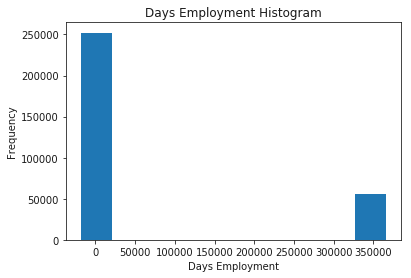

In [77]:
application_train['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram');
plt.xlabel('Days Employment');

## ??
Just out of curiousity, let's subset the anomalous clients and see if they tend to have higher or low rates of default than the rest of the clients.

In [80]:
anom = application_train[application_train['DAYS_EMPLOYED'] == 365243]
non_anom = application_train[application_train['DAYS_EMPLOYED'] != 365243]
print('The non-anomalies default on %0.2f%% of loans' % (100 * non_anom['TARGET'].mean()))
print('The anomalies default on %0.2f%% of loans' % (100 * anom['TARGET'].mean()))
print('There are %d anomalous days of employment' % len(anom))

The non-anomalies default on 8.66% of loans
The anomalies default on 5.40% of loans
There are 55374 anomalous days of employment


Well that is extremely interesting! It turns out that the anomalies have a lower rate of default.

Handling the anomalies depends on the exact situation, with no set rules. 

One of the safest approaches is just to set the anomalies to a missing value and then have them filled in (using Imputation) before machine learning. 

In this case, since all the anomalies have the exact same value, we want to fill them in with the same value in case all of these loans share something in common. 

The anomalous values seem to have some importance, so we want to tell the machine learning model if we did in fact fill in these values. 

As a solution, we will fill in the anomalous values with not a number (np.nan) 
and then create a new boolean column indicating whether or not the value was anomalous.

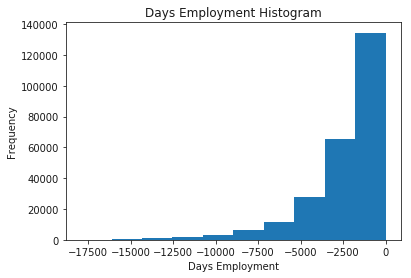

In [82]:
# Create an anomalous flag column
application_train['DAYS_EMPLOYED_ANOM'] = application_train["DAYS_EMPLOYED"] == 365243

# Replace the anomalous values with nan
application_train['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)
application_train
application_train['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram');
plt.xlabel('Days Employment');

The distribution looks to be much more in line with what we would expect, 

and we also have created a new column to tell the model that these values were originally anomalous 

(becuase we will have to fill in the nans with some value, probably the median of the column). 

The other columns with DAYS in the dataframe look to be about what we expect with no obvious outliers.

As an extremely important note, anything we do to the training data we also have to do to the testing data. 

Let's make sure to create the new column and fill in the existing column with np.nan in the testing data.

In [86]:
application_train['DAYS_EMPLOYED_ANOM'] = application_train["DAYS_EMPLOYED"] == 365243
application_train["DAYS_EMPLOYED"].replace({365243: np.nan}, inplace = True)

print('There are %d anomalies in the test data out of %d entries' % (application_train["DAYS_EMPLOYED_ANOM"].sum(), len(application_train)))

There are 0 anomalies in the test data out of 307511 entries


??? That 0 looks wrong ???
There are 0 anomalies in the test data out of 307511 entries
?????
#### check  my Capstone-04-Take02 NOTEBOOK
There are 9274 anomalies in the test data out of 48744 entries
### ?????/
???????
??????

## Correlations
Now that we have dealt with the categorical variables and the outliers, let's continue with the EDA. 

One way to try and understand the data is by looking for correlations between the features and the target. 

We can calculate the Pearson correlation coefficient between every variable and the target using the .corr dataframe method.
==>

The correlation coefficient is not the greatest method to represent "relevance" of a feature, 

but it does give us an idea of possible relationships within the data. 

Some general interpretations of the absolute value of the correlation coefficent are:

.00-.19 “very weak”

.20-.39 “weak”

.40-.59 “moderate”

.60-.79 “strong”

.80-1.0 “very strong”

In [89]:
 # Find correlations with the target and sort
correlations = application_train.corr()['TARGET'].sort_values()


# Display correlations
print('Most Positive Correlations:\n', correlations.tail(15))
print('\nMost Negative Correlations:\n', correlations.head(15))

Most Positive Correlations:
 LIVE_CITY_NOT_WORK_CITY        0.032518
OWN_CAR_AGE                    0.037612
DAYS_REGISTRATION              0.041975
FLAG_DOCUMENT_3                0.044346
REG_CITY_NOT_LIVE_CITY         0.044395
FLAG_EMP_PHONE                 0.045982
REG_CITY_NOT_WORK_CITY         0.050994
DAYS_ID_PUBLISH                0.051457
DAYS_LAST_PHONE_CHANGE         0.055218
REGION_RATING_CLIENT           0.058899
REGION_RATING_CLIENT_W_CITY    0.060893
DAYS_EMPLOYED                  0.074958
DAYS_BIRTH                     0.078239
TARGET                         1.000000
DAYS_EMPLOYED_ANOM                  NaN
Name: TARGET, dtype: float64

Most Negative Correlations:
 EXT_SOURCE_3                 -0.178919
EXT_SOURCE_2                 -0.160472
EXT_SOURCE_1                 -0.155317
FLOORSMAX_AVG                -0.044003
FLOORSMAX_MEDI               -0.043768
FLOORSMAX_MODE               -0.043226
AMT_GOODS_PRICE              -0.039645
REGION_POPULATION_RELATIVE   -0.037227


SOURCE: https://nycdatascience.com/blog/student-works/prediction-of-credit-default-risk/
## Evaluation Metric
Evaluation metric was the Receiver Operating Characteristic Area Under the Curve (ROC AUC, also sometimes called AUROC). This is useful as the data-set was imbalanced with just 8.07% default-rate. With this data even if one classifies all the loans as no-default the accuracy will be 91.93%! Even though such a prediction will have zero True-Positive-Rate (sensitivity).




When we measure a classifier according to the ROC AUC, we do not predict default/no-default, but instead predict the probability of default (between 0 and 1). The ROC curve is developed by plotting the ratio of True-Positive-Rate and False-Positive-Rate (TPR / FPR) for different values of the threshold from 0 to 1. AUC ROC is the total area under the ROC curve for the threshold range (0, 1).

## Distribution of AMT_INCOME_TOTAL (Monthly Amount of Income by each client)

In [16]:
application_train[application_train['AMT_INCOME_TOTAL'] < 2000000]['AMT_INCOME_TOTAL'].iplot(kind='histogram', bins=100,
   xTitle = 'Total Income', yTitle ='Count of applicants',
             title='Distribution of AMT_INCOME_TOTAL')

In [17]:
#Above data output in % percentage
(application_train[application_train['AMT_INCOME_TOTAL'] > 1000000]['TARGET'].value_counts())/len(application_train[application_train['AMT_INCOME_TOTAL'] > 1000000])*100


0    94.8
1     5.2
Name: TARGET, dtype: float64

## OBS:
*  The distribution is right skewed and there are extreme values, we can apply log distribution.
*  People with high income(>1000000) are likely to repay the loan

## Types of Loans available

### Application data
Loan types
Let's see the type of the loans taken and also, on a separate plot, the percent of the loans (by type of the loan) with TARGET value 1 (not returned loan).

In [19]:
cf.set_config_file(theme='polar')
contract_val = application_train['NAME_CONTRACT_TYPE'].value_counts()
contract_df = pd.DataFrame({'labels': contract_val.index,
                   'values': contract_val.values
                  })
contract_df.iplot(kind='pie',labels='labels',values='values', title='Types of Loan', hole = 0.6)

In [54]:
def plot_stats(feature,label_rotation=False,horizontal_layout=True):
    temp = application_train[feature].value_counts()
    df1 = pd.DataFrame({feature: temp.index,'Number of contracts': temp.values})

    # Calculate the percentage of target=1 per category value
    cat_perc = application_train[[feature, 'TARGET']].groupby([feature],as_index=False).mean()
    cat_perc.sort_values(by='TARGET', ascending=False, inplace=True)
    
    if(horizontal_layout):
        fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12,6))
    else:
        fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(12,14))
    sns.set_color_codes("pastel")
    s = sns.barplot(ax=ax1, x = feature, y="Number of contracts",data=df1)
    if(label_rotation):
        s.set_xticklabels(s.get_xticklabels(),rotation=90)
    
    s = sns.barplot(ax=ax2, x = feature, y='TARGET', order=cat_perc[feature], data=cat_perc)
    if(label_rotation):
        s.set_xticklabels(s.get_xticklabels(),rotation=90)
    plt.ylabel('Percent of target with value 1 [%]', fontsize=10)
    plt.tick_params(axis='both', which='major', labelsize=10)

    plt.show();

In [55]:
def plot_distribution(var):
    
    i = 0
    t1 = application_train.loc[application_train['TARGET'] != 0]
    t0 = application_train.loc[application_train['TARGET'] == 0]

    sns.set_style('whitegrid')
    plt.figure()
    fig, ax = plt.subplots(2,2,figsize=(12,12))

    for feature in var:
        i += 1
        plt.subplot(2,2,i)
        sns.kdeplot(t1[feature], bw=0.5,label="TARGET = 1")
        sns.kdeplot(t0[feature], bw=0.5,label="TARGET = 0")
        plt.ylabel('Density plot', fontsize=12)
        plt.xlabel(feature, fontsize=12)
        locs, labels = plt.xticks()
        plt.tick_params(axis='both', which='major', labelsize=12)
    plt.show();

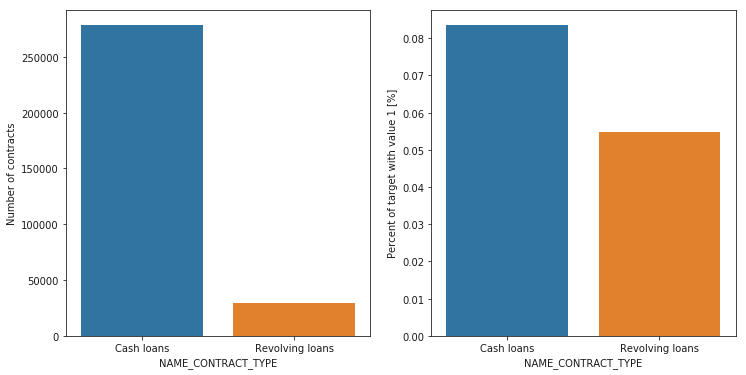

In [56]:
plot_stats('NAME_CONTRACT_TYPE')

## OBS:
* Many people are willing to take cash loan than revolving loan 
* (https://www.investopedia.com/terms/r/revolving-loan-facility.asp).

### INSIGHTs
Contract type Revolving loans are just a small fraction (10%) from the total number of loans; in the same time, a larger amount of Revolving loans, comparing with their frequency, are not repaid.

### Client gender
Let's see the gender of the clients and also, on a separate plot, the percent of the loans (by client gender) with TARGET value 1 (not returned loan).

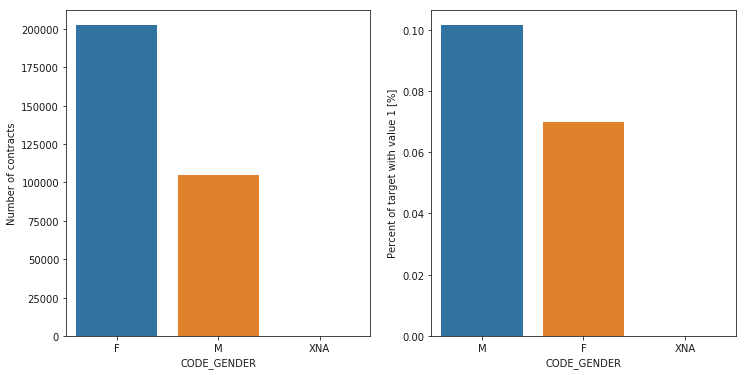

In [57]:
plot_stats('CODE_GENDER')

The number of female clients is almost double the number of male clients. Looking to the percent of defaulted credits, males have a higher chance of not returning their loans (~10%), comparing with women (~7%).

### Flag own car and/OR own real estate¶
Let's inspect the flags that tell us if a client owns a car or real estate and, on separate plots, the percent of the loans value of these flags) with TARGET value 1 (not returned loan).

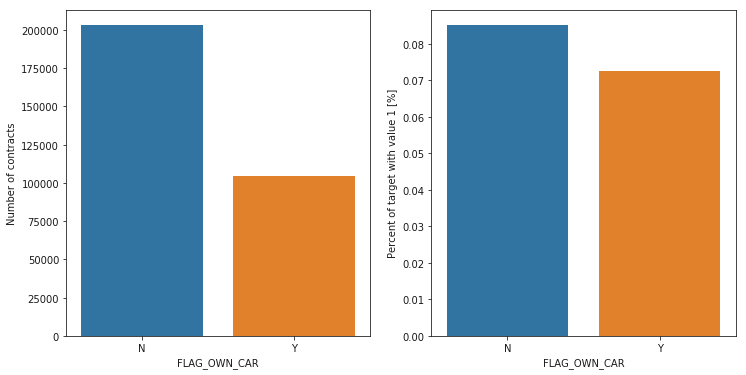

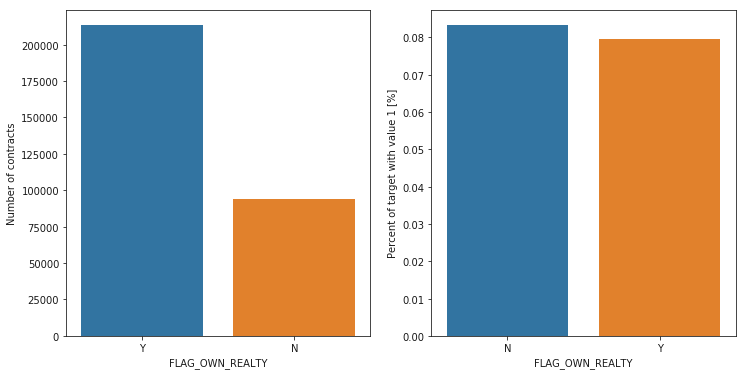

In [58]:
plot_stats('FLAG_OWN_CAR')
plot_stats('FLAG_OWN_REALTY')

#### OBS:
The clients that owns a car are almost a half of the ones that doesn't own one. The clients that owns a car are less likely to not repay a car that the ones that own. Both categories have not-repayment rates around 8%.

The clients that owns real estate are more than double of the ones that doesn't own. Both categories (owning real estate or not owning) have not-repayment rates less than 8%.

## Distribution of client owning a car and by gender
FLAG_OWN_CAR Flag if the client owns a car .
SUBPLOT 1 : Distribution of client owning a car . 34% of clients own a car .
SUBPLOT 1 : Distribution of client owning a car by gender . Out of total clients who own car 57% are male and 43% are female.

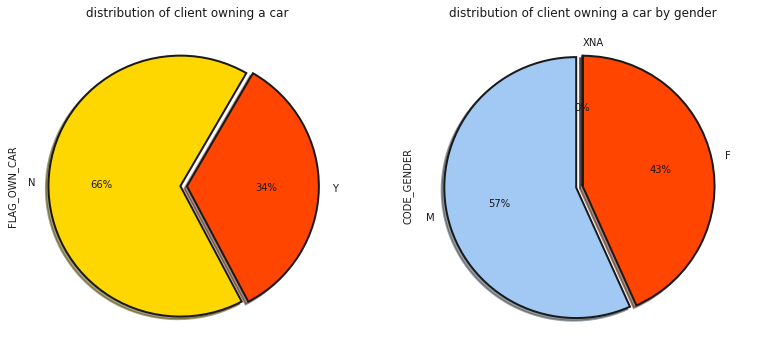

In [59]:
fig = plt.figure(figsize=(13,6))

plt.subplot(121)
data["FLAG_OWN_CAR"].value_counts().plot.pie(autopct = "%1.0f%%",colors = ["gold","orangered"],startangle = 60,
                                                                        wedgeprops={"linewidth":2,"edgecolor":"k"},explode=[.05,0],shadow =True)
plt.title("distribution of client owning a car")

plt.subplot(122)
data[data["FLAG_OWN_CAR"] == "Y"]["CODE_GENDER"].value_counts().plot.pie(autopct = "%1.0f%%",colors = ["b","orangered"],startangle = 90,
                                                                        wedgeprops={"linewidth":2,"edgecolor":"k"},explode=[.05,0,0],shadow =True)
plt.title("distribution of client owning a car by gender")

plt.show()

### Family status of client

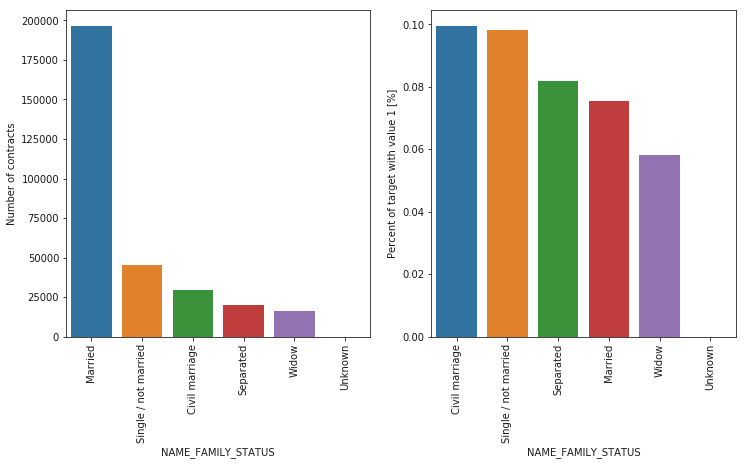

In [60]:
plot_stats('NAME_FAMILY_STATUS',True, True)

#### OBS:
Most of clients are married, followed by Single/not married and civil marriage.

In terms of percentage of not repayment of loan, Civil marriage has the highest percent of not repayment (10%), with Widow the lowest (exception being Unknown).

## Mode Normalized information about building where the client lives.
SOURCE: https://www.kaggle.com/pavanraj159/loan-repayers-v-s-loan-defaulters-home-credit

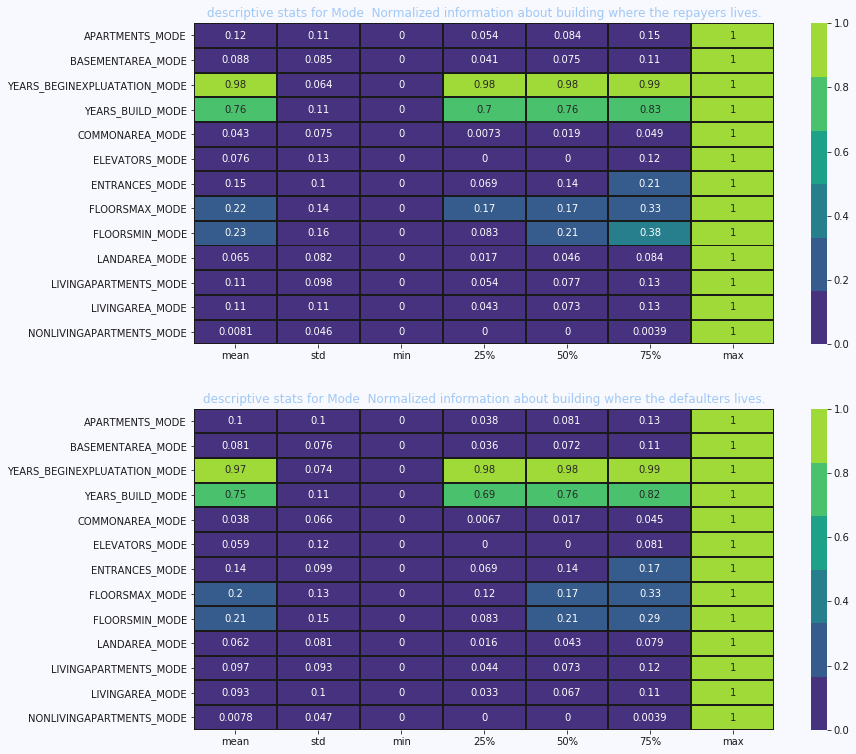

In [62]:
fig = plt.figure(figsize=(13,13))

cols1 = ['APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE',
       'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE',
       'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE',
       'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE']

plt.subplot(211)
sns.heatmap(application_train[application_train["TARGET"] == 0][cols1].describe()[1:].transpose(),annot=True,cmap=sns.color_palette("viridis"),
            linecolor="k",linewidth=1)
plt.title("descriptive stats for Mode  Normalized information about building where the repayers lives.",color="b")

plt.subplot(212)
sns.heatmap(application_train[application_train["TARGET"] == 1][cols1].describe()[1:].transpose(),annot=True,cmap=sns.color_palette("viridis"),
           linecolor="k",linewidth=1)
plt.title("descriptive stats for Mode  Normalized information about building where the defaulters lives.",color="b")
fig.set_facecolor("ghostwhite")

## Median Normalized information about building where the client lives

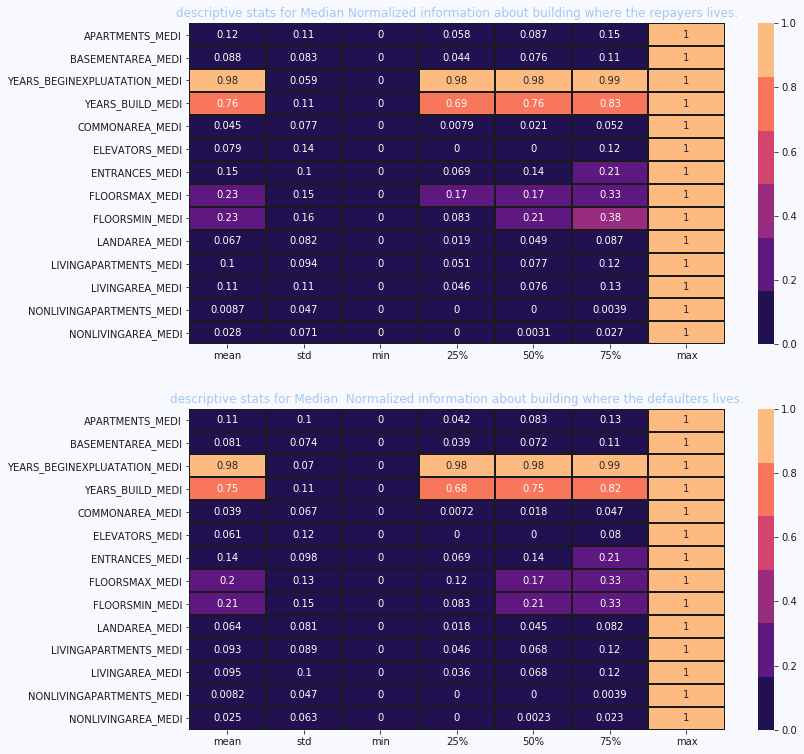

In [63]:
fig = plt.figure(figsize=(12,13))

cols2 = ['APARTMENTS_MEDI', 'BASEMENTAREA_MEDI',
       'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI',
       'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI',
       'LANDAREA_MEDI', 'LIVINGAPARTMENTS_MEDI', 'LIVINGAREA_MEDI',
       'NONLIVINGAPARTMENTS_MEDI', 'NONLIVINGAREA_MEDI']

plt.subplot(211)
sns.heatmap(application_train[application_train["TARGET"] == 0][cols2].describe()[1:].transpose(),
            annot=True,cmap=sns.color_palette("magma"),
            linecolor="k",linewidth=1)
plt.title("descriptive stats for Median Normalized information about building where the repayers lives.",color="b")

plt.subplot(212)
sns.heatmap(application_train[application_train["TARGET"] == 1][cols2].describe()[1:].transpose(),
            annot=True,cmap=sns.color_palette("magma"),
           linecolor="k",linewidth=1)
plt.title("descriptive stats for Median  Normalized information about building where the defaulters lives.",color="b")
fig.set_facecolor("ghostwhite")

## Equiries to Credit Bureau about the client before application.
AMT_REQ_CREDIT_BUREAU_HOUR - Number of enquiries to Credit Bureau about the client one hour before application.

AMT_REQ_CREDIT_BUREAU_DAY - Number of enquiries to Credit Bureau about the client one day before application (excluding one hour before application).

AMT_REQ_CREDIT_BUREAU_WEEK - Number of enquiries to Credit Bureau about the client one week before application (excluding one day before application).

AMT_REQ_CREDIT_BUREAU_MON - Number of enquiries to Credit Bureau about the client one month before application (excluding one week before application).

AMT_REQ_CREDIT_BUREAU_QRT - Number of enquiries to Credit Bureau about the client 3 month before application (excluding one month before application).

AMT_REQ_CREDIT_BUREAU_YEAR - Number of enquiries to Credit Bureau about the client one day year (excluding last 3 months before application).

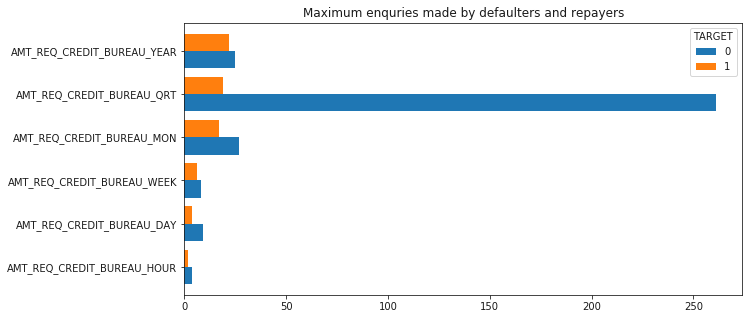

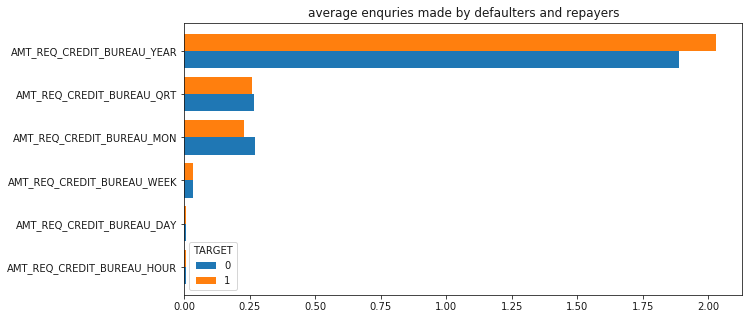

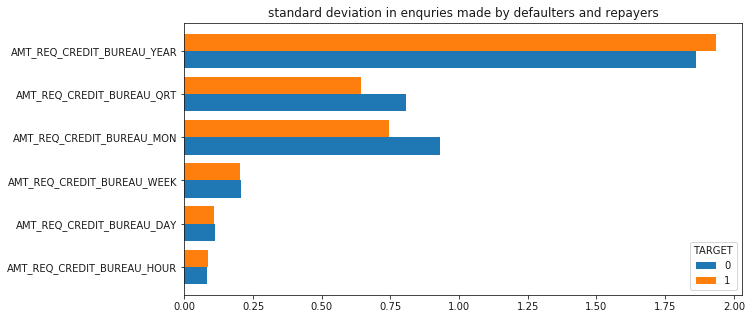

In [64]:
cols = ['AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',
       'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
       'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR']
application_train.groupby("TARGET")[cols].max().transpose().plot(kind="barh",
                                                                 figsize=(10,5),width=.8)
plt.title("Maximum enquries made by defaulters and repayers")
application_train.groupby("TARGET")[cols].mean().transpose().plot(kind="barh",
                                                                  figsize=(10,5),width=.8)
plt.title("average enquries made by defaulters and repayers")
application_train.groupby("TARGET")[cols].std().transpose().plot(kind="barh",
                                                                 figsize=(10,5),width=.8)
plt.title("standard deviation in enquries made by defaulters and repayers")
plt.show()

## Previous credits by repayers and defaulters¶
SK_ID_CURR - ID of loan in our sample - one loan in our sample can have 0,1,2 or more related previous credits in credit bureau .

SK_BUREAU_ID - Recoded ID of previous Credit Bureau credit related to our loan (unique coding for each loan application).

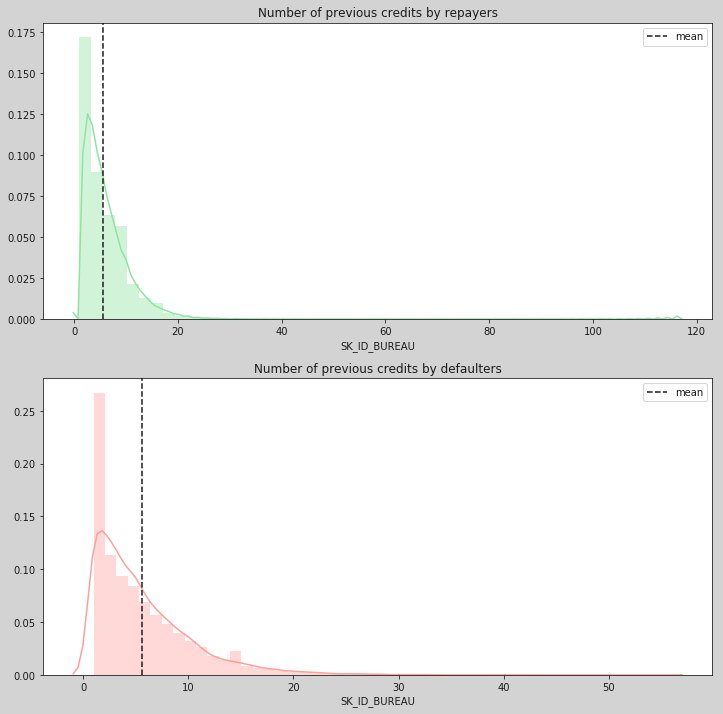

In [65]:
#Merging bureau andapplication train data
app_tar = application_train[["TARGET","SK_ID_CURR"]]
app_bureau = bureau.merge(app_tar,left_on="SK_ID_CURR",right_on="SK_ID_CURR",how="left")


prev_cre = app_bureau.groupby(["TARGET","SK_ID_CURR"])["SK_ID_BUREAU"].nunique().reset_index()
fig = plt.figure(figsize=(12,12))
plt.subplot(211)
sns.distplot(prev_cre[prev_cre["TARGET"]==0]["SK_ID_BUREAU"],color="g")
plt.axvline(prev_cre[prev_cre["TARGET"]==0]["SK_ID_BUREAU"].mean(),linestyle="dashed",color="k",label = "mean")
plt.title("Number of previous credits by repayers")
plt.legend(loc="best")

plt.subplot(212)
sns.distplot(prev_cre[prev_cre["TARGET"]==1]["SK_ID_BUREAU"],color="r")
plt.axvline(prev_cre[prev_cre["TARGET"]==1]["SK_ID_BUREAU"].mean(),linestyle="dashed",color="k",label = "mean")
plt.legend(loc="best")
plt.title("Number of previous credits by defaulters")
fig.set_facecolor("lightgrey")

## Distribution in Client suite type & client type.
NAME_TYPE_SUITE - Who accompanied client when applying for the previous application.

NAME_CLIENT_TYPE - Was the client old or new client when applying for the previous application.

About 60% clients are un-accompained when applying for loans.

While 73% clients are old clients

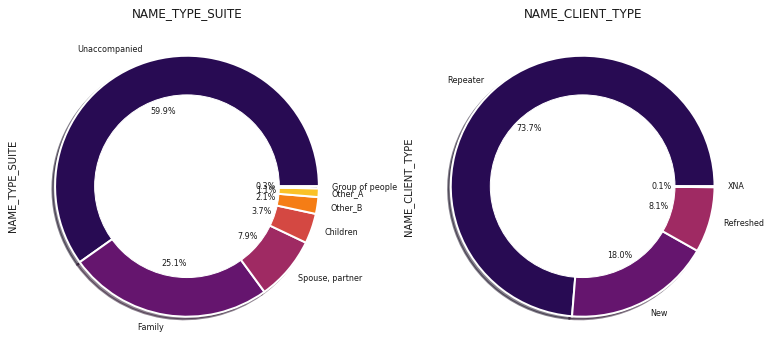

In [66]:
plt.figure(figsize=(13,6))
plt.subplot(121)
previous_application["NAME_TYPE_SUITE"].value_counts().plot.pie(autopct = "%1.1f%%",fontsize=8,
                                                             colors = sns.color_palette("inferno"),
                                              wedgeprops={"linewidth":2,"edgecolor":"white"},shadow =True)
circ = plt.Circle((0,0),.7,color="white")
plt.gca().add_artist(circ)
plt.title("NAME_TYPE_SUITE")

plt.subplot(122)
previous_application["NAME_CLIENT_TYPE"].value_counts().plot.pie(autopct = "%1.1f%%",fontsize=8,
                                                             colors = sns.color_palette("inferno"),
                                              wedgeprops={"linewidth":2,"edgecolor":"white"},shadow =True)
circ = plt.Circle((0,0),.7,color="white")
plt.gca().add_artist(circ)
plt.title("NAME_CLIENT_TYPE")
plt.show()

## Popular goods & REASONS clients were applying for loans¶
NAME_GOODS_CATEGORY - What kind of goods did the client apply for in the previous application.

XNA ,Mobiles ,Computers and consumer electronics are popular goods for applying loans

XNA == NULL ??? explain.....

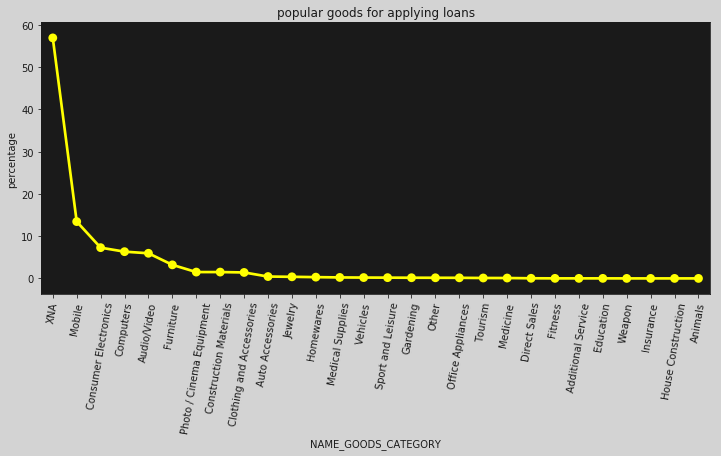

In [67]:
goods = previous_application["NAME_GOODS_CATEGORY"].value_counts().reset_index()
goods["percentage"] = round(goods["NAME_GOODS_CATEGORY"]*100/goods["NAME_GOODS_CATEGORY"].sum(),2)
fig = plt.figure(figsize=(12,5))
ax = sns.pointplot("index","percentage",data=goods,color="yellow")
plt.xticks(rotation = 80)
plt.xlabel("NAME_GOODS_CATEGORY")
plt.ylabel("percentage")
plt.title("popular goods for applying loans")
ax.set_facecolor("k")
fig.set_facecolor('lightgrey')

In [68]:
ext_data = application_train[['TARGET', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH']]
ext_data_corrs = ext_data.corr()
ext_data_corrs

,TARGET,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,DAYS_BIRTH
TARGET,1.000000,-0.155317,-0.160472,-0.178919,0.078239
EXT_SOURCE_1,-0.155317,1.000000,0.213982,0.186846,-0.600610
EXT_SOURCE_2,-0.160472,0.213982,1.000000,0.109167,-0.091996
EXT_SOURCE_3,-0.178919,0.186846,0.109167,1.000000,-0.205478
DAYS_BIRTH,0.078239,-0.600610,-0.091996,-0.205478,1.000000


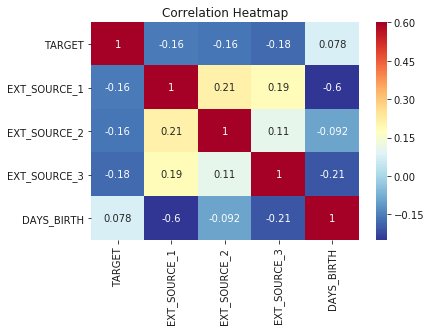

In [69]:
sns.heatmap(ext_data_corrs, cmap = plt.cm.RdYlBu_r, vmin = -0.25, annot = True, vmax = 0.6)
plt.title('Correlation Heatmap');

In [ ]:
???????????????????

## Distribution of AMT_CREDIT

In [20]:
application_train['AMT_CREDIT'].iplot(kind='histogram', bins=100,
            xTitle = 'Credit Amount',yTitle ='Count of applicants',
            title='Distribution of AMT_CREDIT')

In [21]:
np.log(application_train['AMT_CREDIT']).iplot(kind='histogram', bins=100,
        xTitle = 'log(Credit Amount)',yTitle ='Count of applicants',
        title='Distribution of log(AMT_CREDIT)')

Observations:
* People who are taking credit for large amount are very likely to repay the loan.
* Originally the distribution is right skewed, we used log transformation to make it normal distributed.

https://machinelearningmastery.com/how-to-transform-data-to-fit-the-normal-distribution/

Next let’s check for the number of categorical and numerical features to see the split.

# integer valued features
integer_application_train = application_train.select_dtypes(include=['int'])
integer_application_train.drop(columns=['SK_ID_CURR', 'TARGET'], axis=1, inplace=True)

# Some integer features are actually categorical features. 
## So we need to extract these columns
binary_cols = [col for col in integer_application_train if (list(integer_application_train[col].unique()) == [0, 1]) or (list(integer_application_train[col].unique()) == [1, 0])]
integer_application_train.shape

?????????? ABove ??????

In [22]:
# categorical features
categorical_application_train = application_train.select_dtypes(exclude=['int', 'float'])
categorical_application_train.shape

(307511, 16)

In [27]:
# float valued features
float_application_train = application_train.select_dtypes(exclude=['int', 'object'])
float_application_train.shape

(307511, 65)

## OBS:
* There is a larger presence of numerical features in our dataset. 
* These numerical features can be divided into integer type features and float type features. 

In further analysis, as we drill down we can see that a majority of our numerical features, like for example: 
* FLAG_DOCUMENT, 
* FLAG_EMAIL, 
* REG_CITY_NOT_LIVE_CITY,
* ..we may need to include more (?)...

Are actually encoding categorical information, so we will include them in our categorical features dataset.

## Check for "Missing Data"

In [23]:
## SOURCE: https://medium.com/@praveenkotha/home-credit-default-risk-end-to-end-machine-learning-project-1871f52e3ef2


count = application_train.isnull().sum().sort_values(ascending=False)
percentage = ((application_train.isnull().sum()/len(application_train)*100)).sort_values(ascending=False)
missing_application_train = pd.concat([count, percentage], axis=1, keys=['Count','Percentage'])
print('Count and percentage of missing values for top 20 columns:')
missing_application_train.head(20)

Count and percentage of missing values for top 20 columns:


,Count,Percentage
COMMONAREA_MEDI,214865,69.872297
COMMONAREA_AVG,214865,69.872297
COMMONAREA_MODE,214865,69.872297
NONLIVINGAPARTMENTS_MODE,213514,69.432963
NONLIVINGAPARTMENTS_MEDI,213514,69.432963
NONLIVINGAPARTMENTS_AVG,213514,69.432963
FONDKAPREMONT_MODE,210295,68.386172
LIVINGAPARTMENTS_MEDI,210199,68.354953
LIVINGAPARTMENTS_MODE,210199,68.354953
LIVINGAPARTMENTS_AVG,210199,68.354953


## OBS:
* There are lot of missing values in each column.
* These missing values will need to be dealt with in some manner in order to properly use this data.. there are several ways this can be done... 

lets figure out the BEST WAY,,,, and WHY that is so....

?????

In [33]:
def missing_data(data):
    total = data.isnull().sum().sort_values(ascending = False)
    percent = (data.isnull().sum()/data.isnull().count()*100).sort_values(ascending = False)
    return pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])

In [37]:
## application_test
missing_data(application_test).head(10)

,Total,Percent
COMMONAREA_MEDI,33495,68.716150
COMMONAREA_AVG,33495,68.716150
COMMONAREA_MODE,33495,68.716150
NONLIVINGAPARTMENTS_MODE,33347,68.412523
NONLIVINGAPARTMENTS_MEDI,33347,68.412523
NONLIVINGAPARTMENTS_AVG,33347,68.412523
FONDKAPREMONT_MODE,32797,67.284179
LIVINGAPARTMENTS_AVG,32780,67.249302
LIVINGAPARTMENTS_MEDI,32780,67.249302
LIVINGAPARTMENTS_MODE,32780,67.249302


In [36]:
## application_train
missing_data(application_train).head(10)

,Total,Percent
COMMONAREA_MEDI,214865,69.872297
COMMONAREA_AVG,214865,69.872297
COMMONAREA_MODE,214865,69.872297
NONLIVINGAPARTMENTS_MODE,213514,69.432963
NONLIVINGAPARTMENTS_MEDI,213514,69.432963
NONLIVINGAPARTMENTS_AVG,213514,69.432963
FONDKAPREMONT_MODE,210295,68.386172
LIVINGAPARTMENTS_MEDI,210199,68.354953
LIVINGAPARTMENTS_MODE,210199,68.354953
LIVINGAPARTMENTS_AVG,210199,68.354953


In [38]:
## bureau
missing_data(bureau)

,Total,Percent
AMT_ANNUITY,1226791,71.473490
AMT_CREDIT_MAX_OVERDUE,1124488,65.513264
DAYS_ENDDATE_FACT,633653,36.916958
AMT_CREDIT_SUM_LIMIT,591780,34.477415
AMT_CREDIT_SUM_DEBT,257669,15.011932
DAYS_CREDIT_ENDDATE,105553,6.149573
AMT_CREDIT_SUM,13,0.000757
CREDIT_TYPE,0,0.000000
AMT_CREDIT_SUM_OVERDUE,0,0.000000
CNT_CREDIT_PROLONG,0,0.000000


In [39]:
## bureau balance 
missing_data(bureau_balance)

,Total,Percent
STATUS,0,0.0
MonthsBALANCE,0,0.0
SK_ID_BUREAU,0,0.0


In [40]:
## credit card balance
missing_data(credit_card_balance)

,Total,Percent
AMT_PAYMENT_CURRENT,767988,19.998063
AMT_DRAWINGS_OTHER_CURRENT,749816,19.524872
CNT_DRAWINGS_POS_CURRENT,749816,19.524872
CNT_DRAWINGS_OTHER_CURRENT,749816,19.524872
CNT_DRAWINGS_ATM_CURRENT,749816,19.524872
AMT_DRAWINGS_ATM_CURRENT,749816,19.524872
AMT_DRAWINGS_POS_CURRENT,749816,19.524872
CNT_INSTALMENT_MATURE_CUM,305236,7.948208
AMT_INST_MIN_REGULARITY,305236,7.948208
SK_DPD_DEF,0,0.000000


In [41]:
## installments_payments
missing_data(installments_payments)

,Total,Percent
AMT_PAYMENT,2905,0.021352
DAYS_ENTRY_PAYMENT,2905,0.021352
AMT_INSTALMENT,0,0.000000
DAYS_INSTALMENT,0,0.000000
NUM_INSTALMENT_NUMBER,0,0.000000
NUM_INSTALMENT_VERSION,0,0.000000
SK_ID_CURR,0,0.000000
SK_ID_PREV,0,0.000000


In [42]:
## previous_application
missing_data(previous_application).head(20)

,Total,Percent
RATE_INTEREST_PRIVILEGED,1664263,99.643698
RATE_INTEREST_PRIMARY,1664263,99.643698
RATE_DOWN_PAYMENT,895844,53.636480
AMT_DOWN_PAYMENT,895844,53.636480
NAME_TYPE_SUITE,820405,49.119754
DAYS_TERMINATION,673065,40.298129
NFLAG_INSURED_ON_APPROVAL,673065,40.298129
DAYS_FIRST_DRAWING,673065,40.298129
DAYS_FIRST_DUE,673065,40.298129
DAYS_LAST_DUE_1ST_VERSION,673065,40.298129


In [43]:
## POS_CASH_balance
missing_data(POS_CASH_balance)

,Total,Percent
CNT_INSTALMENT_FUTURE,26087,0.260835
CNT_INSTALMENT,26071,0.260675
SK_DPD_DEF,0,0.000000
SK_DPD,0,0.000000
NAME_CONTRACT_STATUS,0,0.000000
MONTHS_BALANCE,0,0.000000
SK_ID_CURR,0,0.000000
SK_ID_PREV,0,0.000000


## Percentage of Missing values in application train and test data


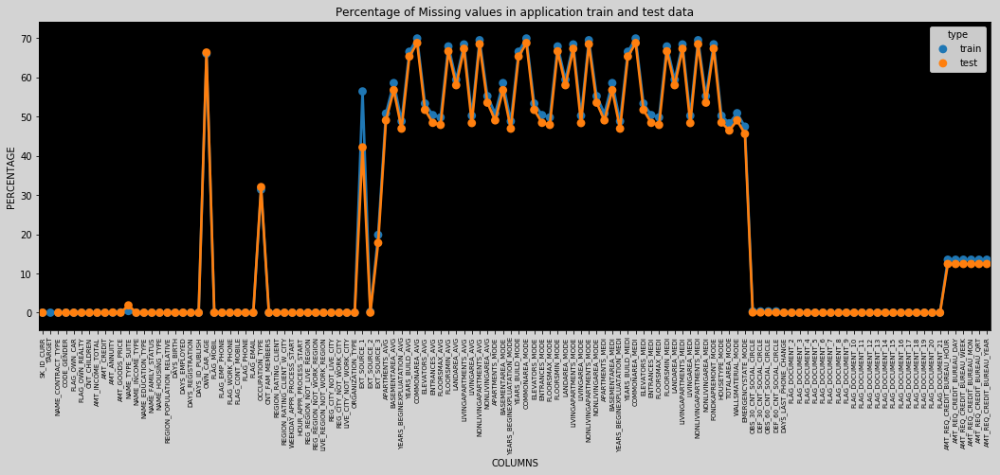

In [44]:
fig = plt.figure(figsize=(18,6))
miss_train = pd.DataFrame((application_train.isnull().sum())*100/application_train.shape[0]).reset_index()
miss_test = pd.DataFrame((application_test.isnull().sum())*100/application_test.shape[0]).reset_index()
miss_train["type"] = "train"
miss_test["type"]  =  "test"
missing = pd.concat([miss_train,miss_test],axis=0)
ax = sns.pointplot("index",0,data=missing,hue="type")
plt.xticks(rotation =90,fontsize =7)
plt.title("Percentage of Missing values in application train and test data")
plt.ylabel("PERCENTAGE")
plt.xlabel("COLUMNS")
ax.set_facecolor("k")
fig.set_facecolor("lightgrey")

## Percentage of missing values in other data sets


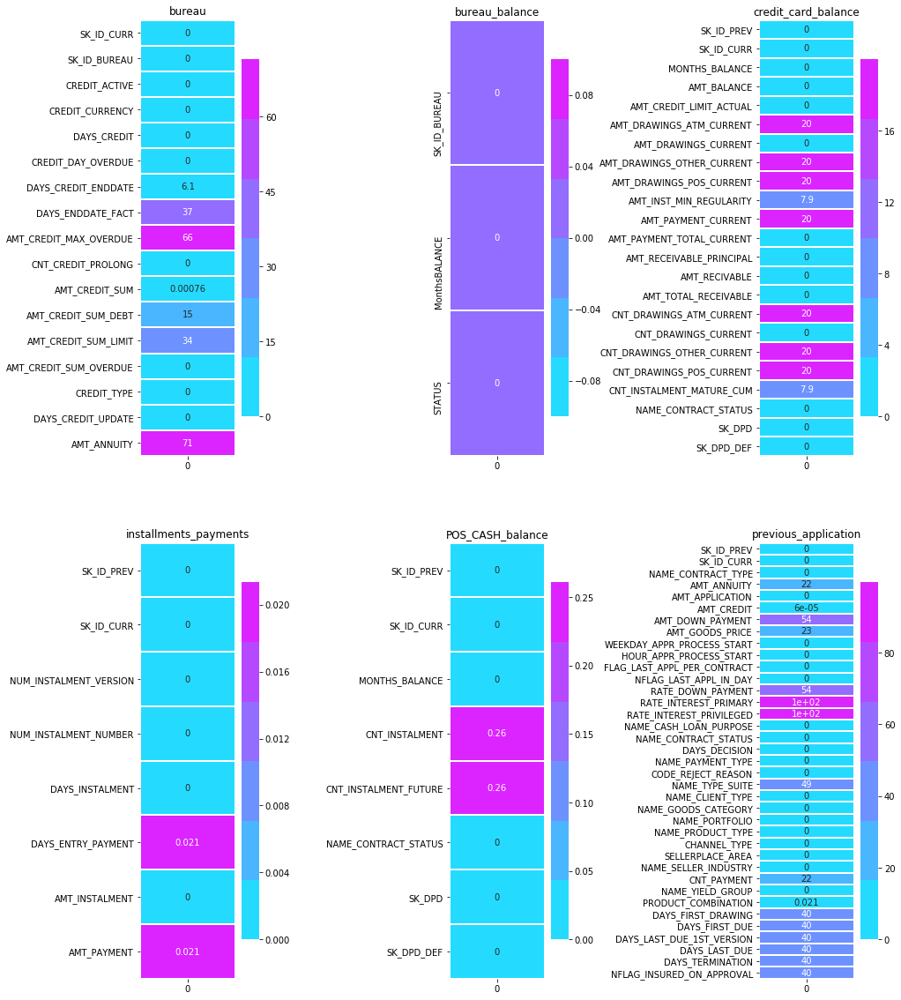

In [45]:
plt.figure(figsize=(15,20))

plt.subplot(231)
sns.heatmap(pd.DataFrame(bureau.isnull().sum()/bureau.shape[0]*100),annot=True,
            cmap=sns.color_palette("cool"),linewidth=1,linecolor="white")
plt.title("bureau")

plt.subplot(232)
sns.heatmap(pd.DataFrame(bureau_balance.isnull().sum()/bureau_balance.shape[0]*100),annot=True,
            cmap=sns.color_palette("cool"),linewidth=1,linecolor="white")
plt.title("bureau_balance")

plt.subplot(233)
sns.heatmap(pd.DataFrame(credit_card_balance.isnull().sum()/credit_card_balance.shape[0]*100),annot=True,
            cmap=sns.color_palette("cool"),linewidth=1,linecolor="white")
plt.title("credit_card_balance")

plt.subplot(234)
sns.heatmap(pd.DataFrame(installments_payments.isnull().sum()/installments_payments.shape[0]*100),annot=True,
            cmap=sns.color_palette("cool"),linewidth=1,linecolor="white")
plt.title("installments_payments")

plt.subplot(235)
sns.heatmap(pd.DataFrame(POS_CASH_balance.isnull().sum()/POS_CASH_balance.shape[0]*100),annot=True,
            cmap=sns.color_palette("cool"),linewidth=1,linecolor="white")
plt.title("POS_CASH_balance")

plt.subplot(236)
sns.heatmap(pd.DataFrame(previous_application.isnull().sum()/previous_application.shape[0]*100),annot=True,
            cmap=sns.color_palette("cool"),linewidth=1,linecolor="white")
plt.title("previous_application")

plt.subplots_adjust(wspace = 1.6)

## Distribution of Target variable
default loan applicant
NOn default

TARGET variable(s):
 
1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in sample, 

0 - all other cases)

INSIGHT: 
8% out of total client population have difficulties in repaying loans.


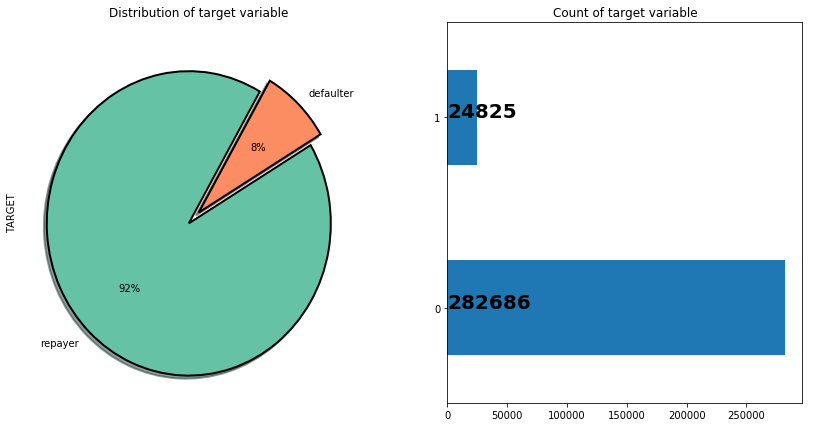

In [47]:
plt.figure(figsize=(14,7))
plt.subplot(121)
application_train["TARGET"].value_counts().plot.pie(autopct = "%1.0f%%",colors = sns.color_palette("Set2",7),startangle = 60,labels=["repayer","defaulter"],
                                                                        wedgeprops={"linewidth":2,"edgecolor":"k"},explode=[.1,0],shadow =True)
plt.title("Distribution of target variable")

plt.subplot(122)
ax = application_train["TARGET"].value_counts().plot(kind="barh")

for i,j in enumerate(application_train["TARGET"].value_counts().values):
    ax.text(.7,i,j,weight = "bold",fontsize=20)

plt.title("Count of target variable")
plt.show()

In [ ]:




???#Concatenating train and test data
 




In [49]:
#Concatenating train and test data
application_train_x = application_train[[x for x in application_train.columns if x not in ["TARGET"]]]
application_train_x["type"] = "train"
application_test["type"]    = "test"
data = pd.concat([application_train_x,application_test],axis=0) 

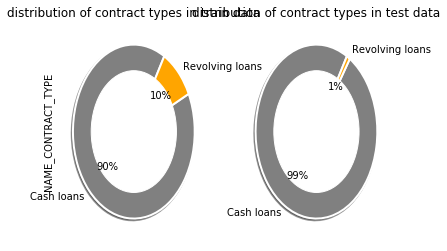

In [50]:
plt.subplot(121)
data[data["type"] == "train"]["NAME_CONTRACT_TYPE"].value_counts().plot.pie(autopct = "%1.0f%%",colors = ["grey","orange"],startangle = 60,
                                                                        wedgeprops={"linewidth":2,"edgecolor":"white"},shadow =True)
circ = plt.Circle((0,0),.7,color="white")
plt.gca().add_artist(circ)
plt.title("distribution of contract types in train data")

plt.subplot(122)
data[data["type"] == "test"]["NAME_CONTRACT_TYPE"].value_counts().plot.pie(autopct = "%1.0f%%",colors = ["grey","orange"],startangle = 60,
                                                                        wedgeprops={"linewidth":2,"edgecolor":"white"},shadow =True)
circ = plt.Circle((0,0),.7,color="white")
plt.gca().add_artist(circ)
plt.ylabel("")
plt.title("distribution of contract types in test data")
plt.show()

## Gender Distribution in training and test data
Train data - Male : 66% ,FEMALE : 34% , Test data - Male : 67% ,FEMALE : 33%

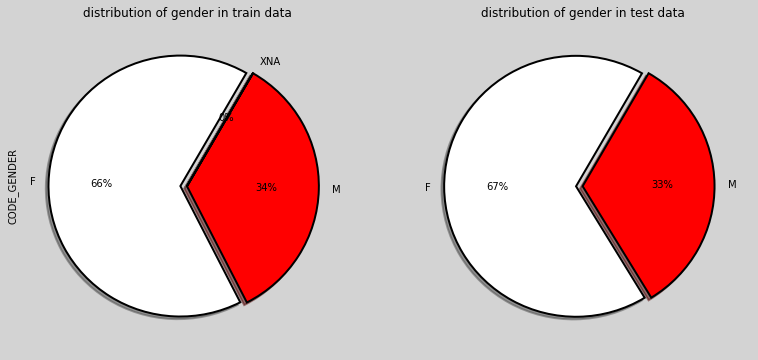

In [51]:
fig = plt.figure(figsize=(13,6))
plt.subplot(121)
data[data["type"] == "train"]["CODE_GENDER"].value_counts().plot.pie(autopct = "%1.0f%%",colors = ["white","r"],startangle = 60,
                                                                        wedgeprops={"linewidth":2,"edgecolor":"k"},explode=[.05,0,0],shadow =True)
plt.title("distribution of gender in train data")

plt.subplot(122)
data[data["type"] == "test"]["CODE_GENDER"].value_counts().plot.pie(autopct = "%1.0f%%",colors = ["white","r"],startangle = 60,
                                                                        wedgeprops={"linewidth":2,"edgecolor":"k"},explode=[.05,0],shadow =True)
plt.ylabel("")
plt.title("distribution of gender in test data")
fig.set_facecolor("lightgrey")

## Distribution of Contract type by gender


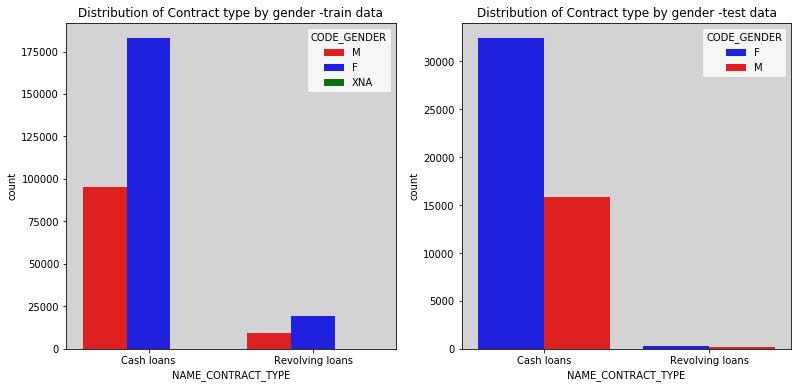

In [52]:
fig  = plt.figure(figsize=(13,6))
plt.subplot(121)
ax = sns.countplot("NAME_CONTRACT_TYPE",hue="CODE_GENDER",data=data[data["type"] == "train"],palette=["r","b","g"])
ax.set_facecolor("lightgrey")
ax.set_title("Distribution of Contract type by gender -train data")

plt.subplot(122)
ax1 = sns.countplot("NAME_CONTRACT_TYPE",hue="CODE_GENDER",data=data[data["type"] == "test"],palette=["b","r"])
ax1.set_facecolor("lightgrey")
ax1.set_title("Distribution of Contract type by gender -test data")
plt.show()

## Next let’s check for duplicate data

In [24]:
columns_without_id = [col for col in application_train.columns if col!='SK_ID_CURR']

#Checking for duplicates in the data.
application_train[application_train.duplicated(subset = columns_without_id, keep=False)]
print('The n# of duplicates in the data:',application_train[application_train.duplicated(subset = columns_without_id, keep=False)]
      .shape[0])

The n# of duplicates in the data: 0


In [25]:
## https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html
## https://www.datacamp.com/community/tutorials/principal-component-analysis-in-python
from sklearn.decomposition import PCA
from sklearn import preprocessing

def do_pca(df):
    min_max_scaler = preprocessing.MinMaxScaler()
    X_normalized = min_max_scaler.fit_transform(df)

    pca = PCA(n_components=10)
    components = pca.fit_transform(X_normalized)
    columns = ['pca-{}'.format(i+1) for i in range(len(components[0,:]))]
    
    return (pca, pd.DataFrame(components, columns=columns))

We can now take a look at the correlation matrix for our "Float valued features" and our "TARGET".

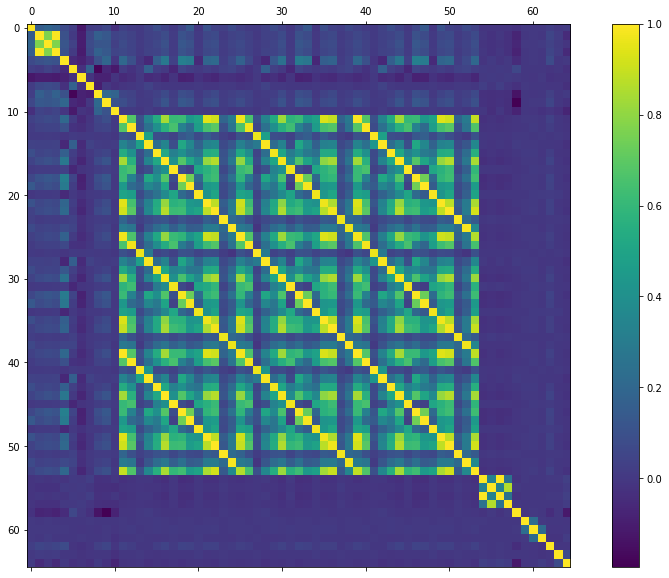

In [28]:
# plot correlation matrix for float type features

float_columns = list(float_application_train.columns)
float_corr = float_application_train.corr()

fig = plt.figure(figsize=(15,10))
ax = fig.add_subplot(111)
cax = ax.matshow(float_corr, interpolation='nearest')
fig.colorbar(cax)
plt.show()

These features are good candidates for dimensionality reduction, since they are adding redundant information to our model. 

We’ll run a Principal Component Analysis (PCA) transformation over these features, and use the top 10 principle components in our classifier. 

These 10 components are able to explain about 77% of the variance in our dataset.

In [29]:
# Select float features for pca transformation
pca_candidates = float_application_train.iloc[:, 11:53]
pca_candidates = pca_candidates.fillna(method='ffill')
pca_candidates = pca_candidates.fillna(method='bfill')
pca, X_pca = do_pca(pca_candidates)

### Top 10 PCA Components

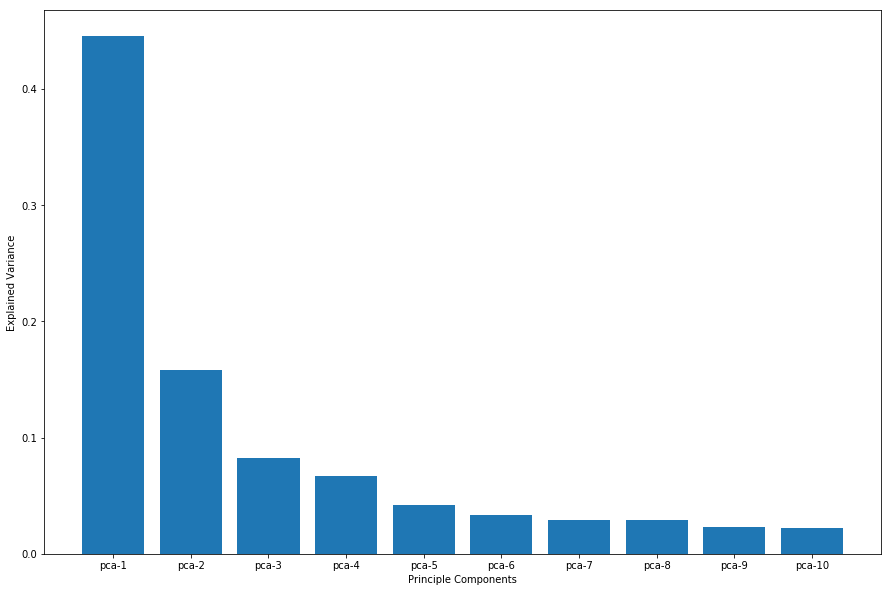

In [31]:
plt.figure(figsize=(15, 10))
plt.bar(X_pca.columns, pca.explained_variance_ratio_)
plt.ylabel('Explained Variance')
plt.xlabel('Principle Components')
##experiment.log_figure(figure_name='Top 10 PCA Components', figure=plt)
plt.show()